In [1]:
# imported packages
import json
import pandas as pd
from pandas import json_normalize
from functools import reduce
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.stats import ks_2samp
import numpy as np
import seaborn as sns
sns.set_style("white")

pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_columns', None)




In [2]:
edu = pd.read_csv('Colleges_and_Universities.csv')
f500 = pd.read_csv('Fortune_500_Corporate_Headquarters.csv')

In [3]:
f500 = f500[["RANK", "NAME", "ADDRESS", "CITY", "STATE", "ZIP", "COUNTY", "LATITUDE", "LONGITUDE", "REVENUES", "EMPLOYEES"]]

In [4]:
edu = edu[["NAME", "ADDRESS", "CITY", "STATE", "ZIP", "COUNTY", "LATITUDE", "LONGITUDE", "POPULATION", "NAICS_DESC"]]

In [5]:
colleges = edu[edu["NAICS_DESC"]=="Colleges, Universities, and Professional Schools"]

In [6]:
# california_edu = edu["NAME"].str.contains("University of California")
# edu[california_edu]

In [7]:
import plotly.express as px
import pandas as pd

fig = px.scatter_geo(edu,lat='LATITUDE',lon='LONGITUDE', hover_name="NAME", scope="usa", locationmode="USA-states")
fig.update_layout(title = 'USA map', title_x=0.5)
fig.update_traces(marker=dict(size=3))
fig.show()

In [8]:
fig = px.scatter_geo(f500,lat='LATITUDE',lon='LONGITUDE', hover_name="NAME", scope="usa", locationmode="USA-states")
fig.update_layout(title = ' map', title_x=0.5)
fig.show()

In [9]:
edu.rename(columns={'NAME': 'name_edu', 'ADDRESS': 'address_edu', 'CITY': 'city_edu',
                    'ZIP': 'zip_edu', 'COUNTY': 'county_edu','LATITUDE': 'lat_edu',
                    'LONGITUDE': 'long_edu', 'POPULATION': 'population_edu',
                    'NAICS_DESC': 'type_edu'}, inplace=True)

In [10]:
# use the merge command to combine dataframes
# pd.merge(edu, f500, on="STATE", how="outer")

### Yelp business.json

In [11]:
# Since we'll repeat the normalization of JSON data for 3 JSON files,
# it's good practice to create functions that convert JSON files into normalized dataframes
def read_json_as_array(json_file): 
    '''
    Read a given Yelp JSON file as string, adding opening / closing
    brackets and commas to convert from separate JSON objects to
    an array of JSON objects, so JSON aware libraries can properly parse it
    Parameters: json_file (file of type json)
    -----------
    Returns:    json_data: str (String representation of JSON array)
    -------
    '''
    json_data = ''
    with open(json_file, 'r', encoding='utf-8') as in_file: 
        for i, line in enumerate(in_file):
            if i == 0 and line: 
                json_data += '[' + line
            elif line:
                json_data += ',' + line
            else: 
                pass
        json_data += ']\n' 
    return json_data


def load_json(json_data): 
    
    '''
    Read and normalize a given JSON array into a pandas DataFrame
    Parameters: json_data: str (String representation of JSON array)
    -----------
    Returns:    df: pandas.DataFrame (DataFrame containing the normalized data)
    -------
    '''
    
    data = json.loads(json_data) 
    df = json_normalize(data)
    return df


business_df = load_json(read_json_as_array("yelp_academic_dataset_business.json"))

In [12]:
# business_df.head(10) #158000 x 14 --> 60 columns

In [13]:
yelp_companies = business_df[["name", "address", "city", "state", "postal_code", "latitude", "longitude", "categories"]]

In [14]:
f500.rename(columns={'RANK': "rank", "NAME": 'name', 'ADDRESS': 'address', 'CITY': 'city',
                    'LATITUDE': 'latitude', 'STATE': 'state',
                    'LONGITUDE': 'longitude'}, inplace=True)

In [118]:
businesses = pd.concat([f500, yelp_companies]).reset_index(drop=True)

In [16]:
fig = px.scatter_geo(businesses,lat='latitude',lon='longitude', hover_name="name", scope="usa", locationmode="USA-states")
fig.update_layout(title = ' map', title_x=0.5)
fig.show()

In [119]:
def merge(list1, list2):
      
    merged_list = [(list1[i], list2[i]) for i in range(0, len(list1))]
    return merged_list

In [120]:
# conda install -c conda-forge geopy

In [121]:
edu_indexes = edu.index
business_indexes = businesses.index

In [123]:
import geopy.distance

# get coordinates for businesses
coords_1_lat = [lat for lat in businesses[0:100]["latitude"]]
coords_1_long = [long for long in businesses[0:100]['longitude']]
# get coordinates for colleges
coords_2_lat = [lat for lat in edu[0:100]["lat_edu"]]
coords_2_long = [long for long in edu[0:100]['long_edu']]

# get tuples of long and lat
coords_comp = merge(coords_1_lat, coords_1_long)
coords_uni = merge(coords_2_lat, coords_2_long)

college_company_dist = []


In [124]:
uni_list = []

for i in range(0, len(coords_uni)):
    companies_lt_40 = []
    distances = []
    for j in range(0, len(coords_comp)):
        distance = geopy.distance.geodesic(coords_uni[i], coords_comp[j]).miles
        if(distance < 40):
            companies_lt_40.append(j)
    #                distances.append(distance)
    uni_list.append({edu['name_edu'][i]: companies_lt_40})

In [125]:
uni_list

[{'Shorter College': []},
 {'Citrus Heights Beauty College': []},
 {'Joe Blasco Makeup Artist Training Center': []},
 {'Waynes College of Beauty': []},
 {'Hult International Business School': []},
 {'Vogue College of Cosmetology': []},
 {'Vogue College - McAllen': []},
 {'Montana Bible College': []},
 {"KC's School of Hair Design": []},
 {'Colton-Redlands-Yucaipa Regional Occupational Program': []},
 {'Cheveux School of Hair Design': []},
 {'Watson School of Biological Sciences at Cold Spring Harbor Laboratory': [25,
   26,
   27,
   28]},
 {'American College of Healthcare Sciences': []},
 {'Universal Technical Institute - Dallas Fort Worth': [51,
   52,
   53,
   54,
   79,
   80,
   81,
   82,
   83,
   84,
   85,
   86,
   87,
   88,
   89,
   90,
   91,
   92]},
 {'International Culinary Center-California': [3, 4, 5, 6, 55]},
 {'Milan Institute-Las Vegas': [46, 47]},
 {'Virginia College-Savannah': []},
 {'Virginia College-Columbus': []},
 {"Donna's Academy of Hair Design": []},
 {'

In [138]:
dan = list(uni_list[11].values())[0]
df = pd.DataFrame (dan, columns = ['indeces'])
df

,indeces
0,25
1,26
2,27
3,28


In [169]:
dan_biz = businesses[["name","latitude","longitude"]].loc[dan]
dan_biz

,name,latitude,longitude
25,SEALED AIR,40.89756,-74.12720
26,BECTON DICKINSON,41.01613,-74.20762
27,ASCENA RETAIL GROUP,41.07444,-74.17075
28,COGNIZANT TECHNOLOGY SOLUTIONS,40.87398,-74.00657


In [162]:
edu_11 = pd.DataFrame(edu.loc[[11]])

In [163]:
edu_11

,name_edu,address_edu,city_edu,STATE,zip_edu,county_edu,lat_edu,long_edu,population_edu,type_edu
11,Watson School of Biological Sciences at Cold Spring Harbor Laboratory,1 Bungtown Rd,Cold Spring Harbor,NY,11724,Nassau,40.867183,-73.472293,9,"Colleges, Universities, and Professional Schools"


In [168]:
fig = plt.figure()
px.scatter_geo(dan_biz, lat='latitude',lon='longitude', hover_name="name", scope="usa", locationmode="USA-states")

px.scatter_geo(edu_11, lat='lat_edu',lon='long_edu', scope="usa", locationmode="USA-states")

plt.show()

<Figure size 432x288 with 0 Axes>

In [143]:


fig = px.scatter_geo(dan_biz,lat='latitude',lon='longitude', hover_name="name", scope="usa", locationmode="USA-states")
fig.update_layout(title = ' map', title_x=0.5)
fig1 = px.scatter_geo(edu,lat='lat_edu',lon='long_edu', scope="usa", locationmode="USA-states")
fig1.update_layout(title = ' map', title_x=0.5)

fig.show()
fig1.show()




In [20]:
california = yelp_companies[yelp_companies["state"] == "FL"]
california

,name,address,city,state,postal_code,latitude,longitude,categories
7,Temple Beth-El,400 Pasadena Ave S,St. Petersburg,FL,33707,27.766590,-82.732983,"Synagogues, Religious Organizations"
10,Marshalls,21705 Village Lakes Sc Dr,Land O' Lakes,FL,34639,28.190459,-82.457380,"Department Stores, Shopping, Fashion"
11,Vietnamese Food Truck,,Tampa Bay,FL,33602,27.955269,-82.456320,"Vietnamese, Food, Restaurants, Food Trucks"
13,Adams Dental,15 N Missouri Ave,Clearwater,FL,33755,27.966235,-82.787412,"General Dentistry, Dentists, Health & Medical, Cosmetic Dentists"
14,Zio's Italian Market,2575 E Bay Dr,Largo,FL,33771,27.916116,-82.760461,"Food, Delis, Italian, Bakeries, Restaurants"
...,...,...,...,...,...,...,...,...
150280,Tampa Bay Club Sport,380 105th Terrace Ne,Saint Petersburg,FL,33716,27.867754,-82.632602,"Active Life, Sports Clubs"
150289,Thoughtful Moving,5004 E Fowler Ave,Tampa,FL,33617,28.054934,-82.400832,"Packing Services, Home Services, Movers, Local Services, Self Storage"
150292,Colony Grill - St. Petersburg,670 Central Ave,St. Petersburg,FL,33701,27.770872,-82.643069,"Bars, Beer Bar, Nightlife, Wine Bars, Pizza, Restaurants"
150317,21 Barber,10937 56th St N,Temple Terrace,FL,33617,28.047632,-82.393519,"Men's Hair Salons, Hair Salons, Barbers, Beauty & Spas"


In [21]:
california["city"].value_counts()

Tampa               9048
Clearwater          2221
Saint Petersburg    1663
St. Petersburg      1185
Brandon             1033
                    ... 
Zephryhills            1
St Petersberg          1
CLEARWATER             1
Clearwater,            1
Apollo beach           1
Name: city, Length: 226, dtype: int64

(Text(0.5, 0, 'Longitude'), Text(0, 0.5, 'Latitude'))

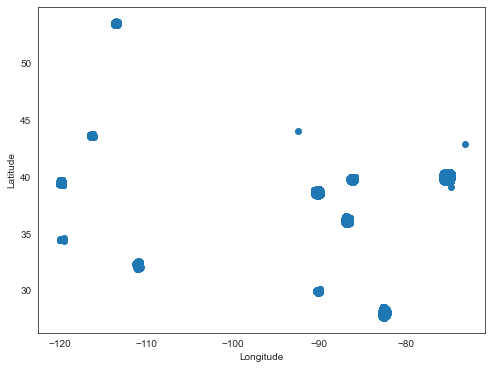

In [22]:
fig, ax = plt.subplots(figsize=(8,6))
plt.scatter(yelp_companies.longitude,yelp_companies.latitude)
plt.xlabel("Longitude"), plt.ylabel("Latitude")

Text(0.5, 0, 'Number of companies')

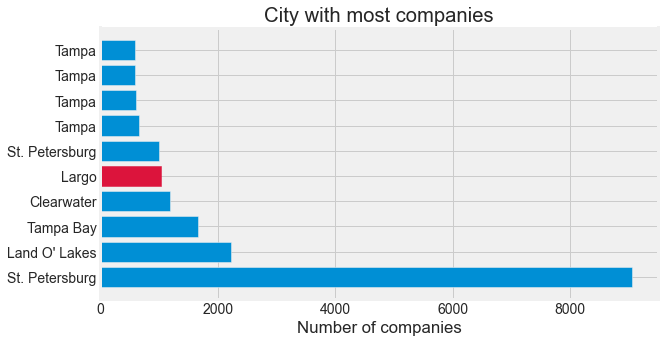

In [23]:
plt.figure(figsize=(10,5))
plt.style.use('fivethirtyeight')
barlist = plt.barh(range(10),california.city.value_counts().head(10))
barlist[4].set_color('crimson')
plt.title('City with most companies')
plt.yticks(range(10), california.city.head(10))
plt.xlabel("Number of companies")

In [24]:
import plotly.express as px
import pandas as pd

fig = px.scatter_geo(california,lat='latitude',lon='longitude', hover_name="name", scope="usa", locationmode="USA-states")
fig.update_layout(title = 'World map', title_x=0.5)
fig.show()

In [25]:
fig = px.choropleth(california,
                    locations='state', 
                    locationmode="USA-states", 
                    scope="usa",
                    color= "is_open",
                    color_continuous_scale="Viridis_r", 
                    
                    )
fig.show()

ValueError: Value of 'color' is not the name of a column in 'data_frame'. Expected one of ['name', 'address', 'city', 'state', 'postal_code', 'latitude', 'longitude', 'categories'] but received: is_open

In [ ]:
# # use the merge command to combine dataframes
# combined_df = reduce(lambda left, right: pd.merge(left, right,
# how = 'outer'),
# [user_df2, review_df2, business_df2])

# combined_df # 180235 rows × 80 columns

In [ ]:
# KS test
# p-value is less than 0.5, meaning that coorelation is insignificant x = review_df['stars']
y = review_df['text_length']
ks_2samp(x, y, mode = "asymp")

In [ ]:
g = sns.FacetGrid(review_df, col="stars")
g.map(plt.hist, "text_length")

In [ ]:
# box plot of text length for each star rating
# shows the skeweness as is shown from the histogram
sns.boxplot(x="stars", y='text_length', data = review_df, palette = "r")

In [ ]:
sns.heatmap(california.corr(), cmap = 'coolwarm', annot = True)